In [1]:
import os
import cv2
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import plotly.express as px
import plotly.graph_objects as go
import seaborn as sns
from sklearn.model_selection import train_test_split

In [2]:
# Import wandb and log in
import wandb

# Log in to wandb with API key
wandb.login(key='9d4d19211298a09d6446b4e64c34b5ce5d025780')

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: Currently logged in as: anantsharma-1839 (anantsharma-1839-op). Use `wandb login --relogin` to force relogin
wandb: WARNING If you're specifying your api key in code, ensure this code is not shared publicly.
wandb: WARNING Consider setting the WANDB_API_KEY environment variable, or running `wandb login` from the command line.
wandb: Appending key for api.wandb.ai to your netrc file: C:\Users\Asus\_netrc


True

In [3]:
# Paths
train_img_path = "dataset-lunar/craters/train/images/"
train_lbl_path = "dataset-lunar/craters/train/labels/"
valid_img_path = "dataset-lunar/craters/valid/images/"
valid_lbl_path = "dataset-lunar/craters/valid/labels/"
test_img_path = "dataset-lunar/craters/test/images/"
test_lbl_path = "dataset-lunar/craters/test/labels/"
model_path = "dataset-lunar/best.pt"
data_yaml_path = "dataset-lunar/data2.yaml"

In [4]:
# EDA and Data Preprocessing
def load_labels(label_path):
    label_files = os.listdir(label_path)
    data = []
    classes = set()
    for file in label_files:
        with open(os.path.join(label_path, file), 'r') as f:
            lines = f.readlines()
            for line in lines:
                parts = list(map(float, line.strip().split()))
                data.append([file, *parts])
                classes.add(int(parts[0]))
    df = pd.DataFrame(data, columns=['file', 'class', 'x_center', 'y_center', 'width', 'height'])
    return df, sorted(classes)

train_labels, train_classes = load_labels(train_lbl_path)
valid_labels, valid_classes = load_labels(valid_lbl_path)
test_labels, test_classes = load_labels(test_lbl_path)

In [5]:
# Get all unique classes
all_classes = sorted(set(train_classes + valid_classes + test_classes))
class_names = [f'class_{i}' for i in all_classes]

In [6]:
# Display first few rows of the labels
print("Train Labels")
print(train_labels.head())
print("\nValidation Labels")
print(valid_labels.head())
print("\nTest Labels")
print(test_labels.head())

Train Labels
                                              file  class  x_center  y_center  \
0  011_png.rf.8ac312b4898f0106d10b76952a55d237.txt    0.0  0.449219  0.076563   
1  011_png.rf.8ac312b4898f0106d10b76952a55d237.txt    0.0  0.323437  0.866406   
2  011_png.rf.8ac312b4898f0106d10b76952a55d237.txt    0.0  0.112500  0.877344   
3  011_png.rf.8ac312b4898f0106d10b76952a55d237.txt    0.0  0.752344  0.917188   
4  011_png.rf.8ac312b4898f0106d10b76952a55d237.txt    0.0  0.618750  0.135156   

      width    height  
0  0.085938  0.096094  
1  0.184375  0.177344  
2  0.215625  0.220312  
3  0.089844  0.100781  
4  0.119531  0.126562  

Validation Labels
                                              file  class  x_center  y_center  \
0  014_png.rf.6b86c8afeb3ebca92872fd966d076adc.txt    0.0  0.781250  0.070312   
1  014_png.rf.6b86c8afeb3ebca92872fd966d076adc.txt    0.0  0.099219  0.070312   
2  014_png.rf.6b86c8afeb3ebca92872fd966d076adc.txt    0.0  0.553125  0.703125   
3  014_png.rf

In [7]:
# Create data.yaml
data_yaml_content = f"""
train: {train_img_path}
val: {valid_img_path}
test: {test_img_path}

nc: {len(all_classes)}  # number of classes
names: {class_names}  # class names
"""

with open(data_yaml_path, 'w') as f:
    f.write(data_yaml_content)

In [8]:
# Plotting distribution of bounding box sizes
def plot_bounding_box_distribution(labels, title):
    labels['area'] = labels['width'] * labels['height']
    fig = px.histogram(labels, x='area', nbins=50, title=title)
    fig.show()

plot_bounding_box_distribution(train_labels, 'Train Bounding Box Area Distribution')
plot_bounding_box_distribution(valid_labels, 'Validation Bounding Box Area Distribution')
plot_bounding_box_distribution(test_labels, 'Test Bounding Box Area Distribution')

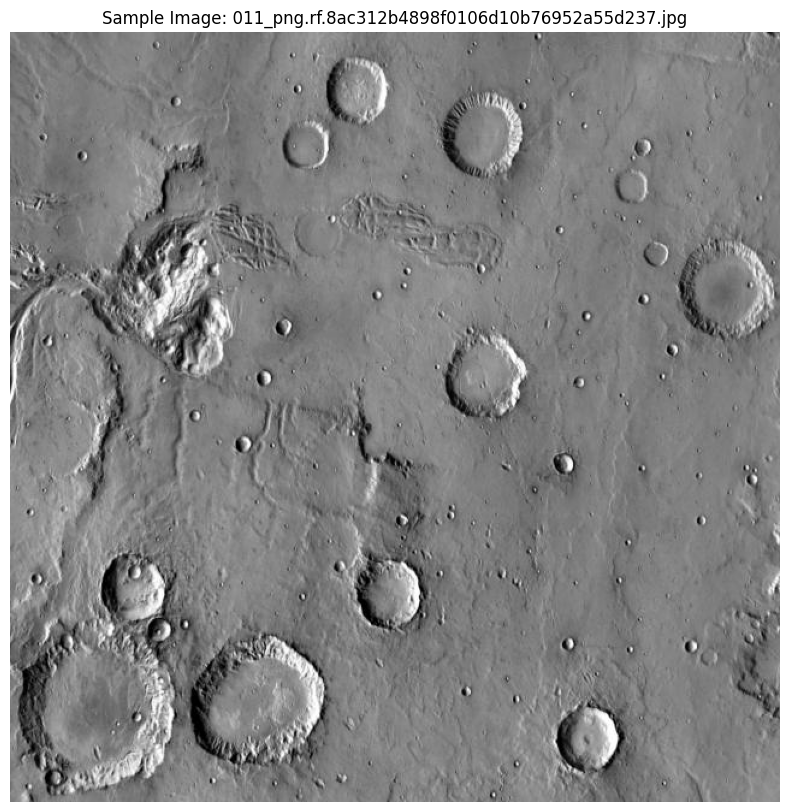

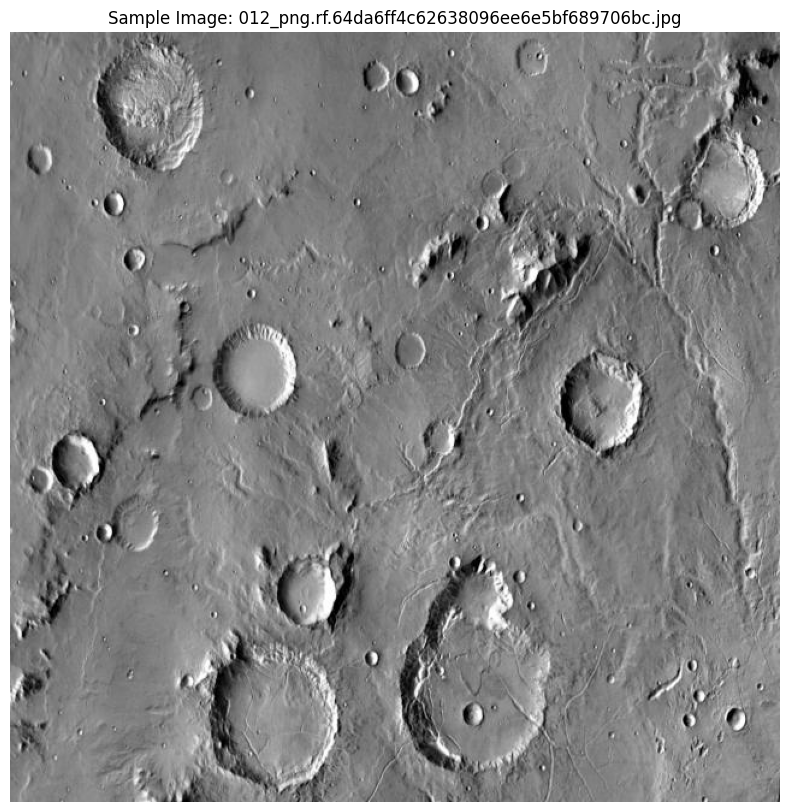

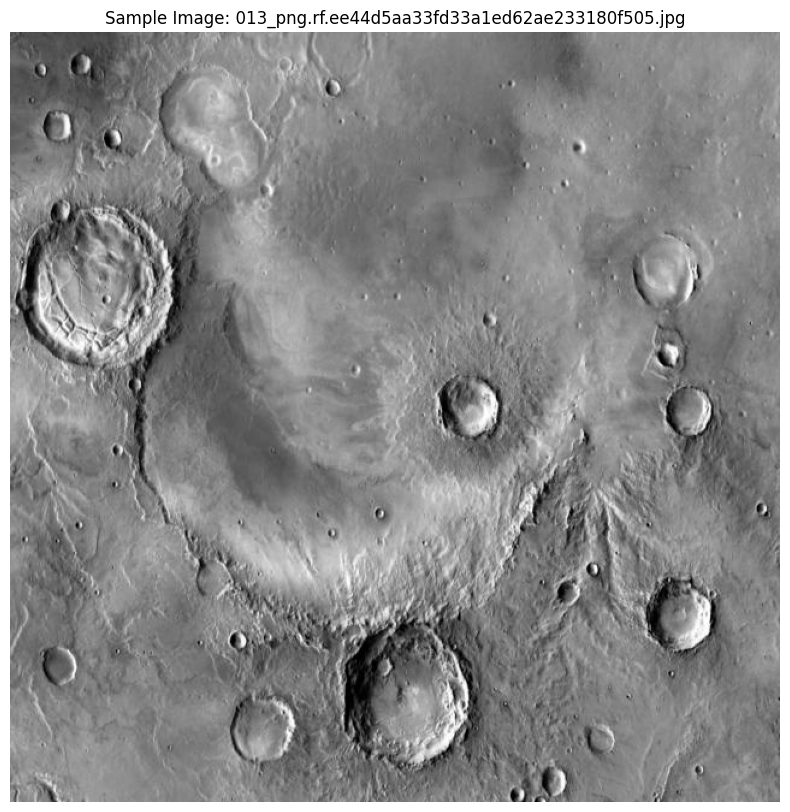

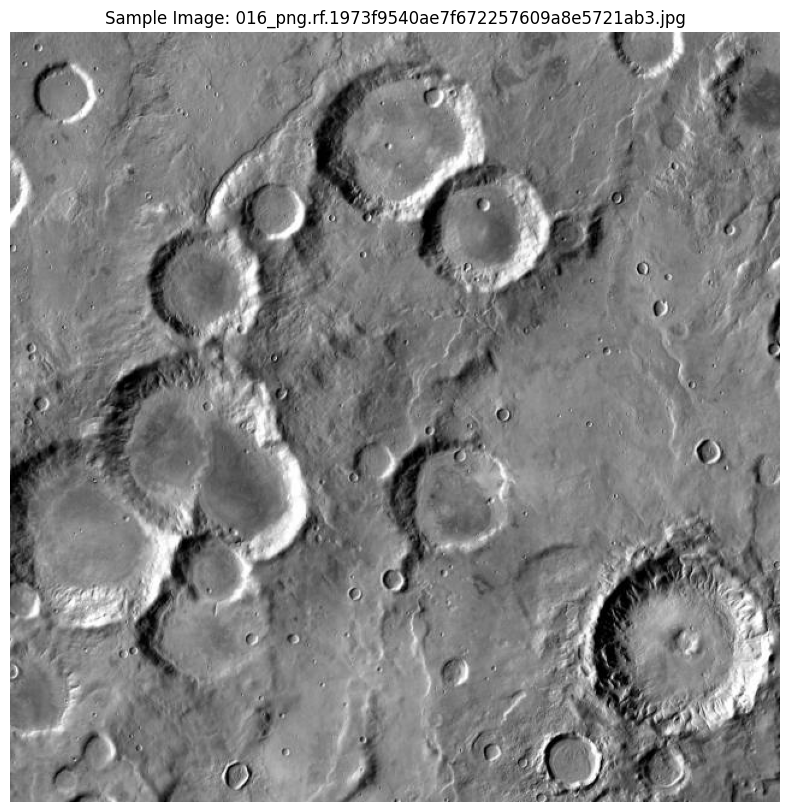

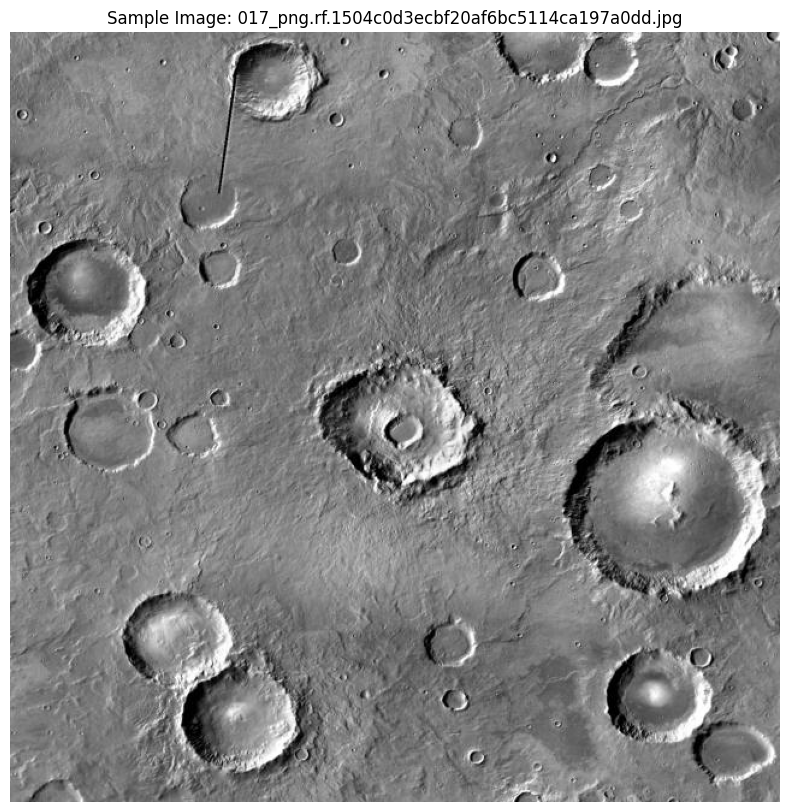

...

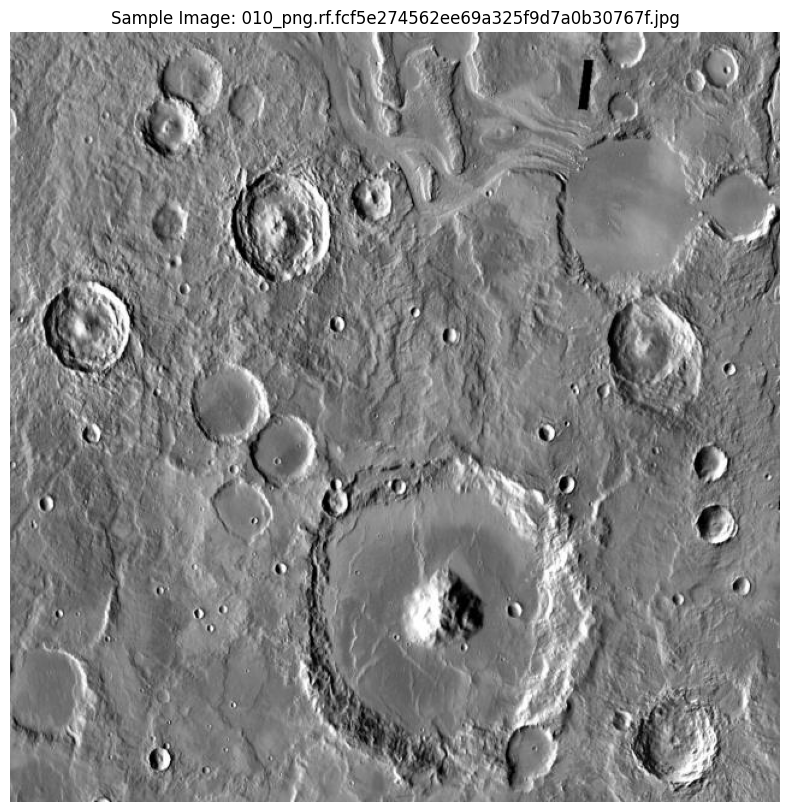

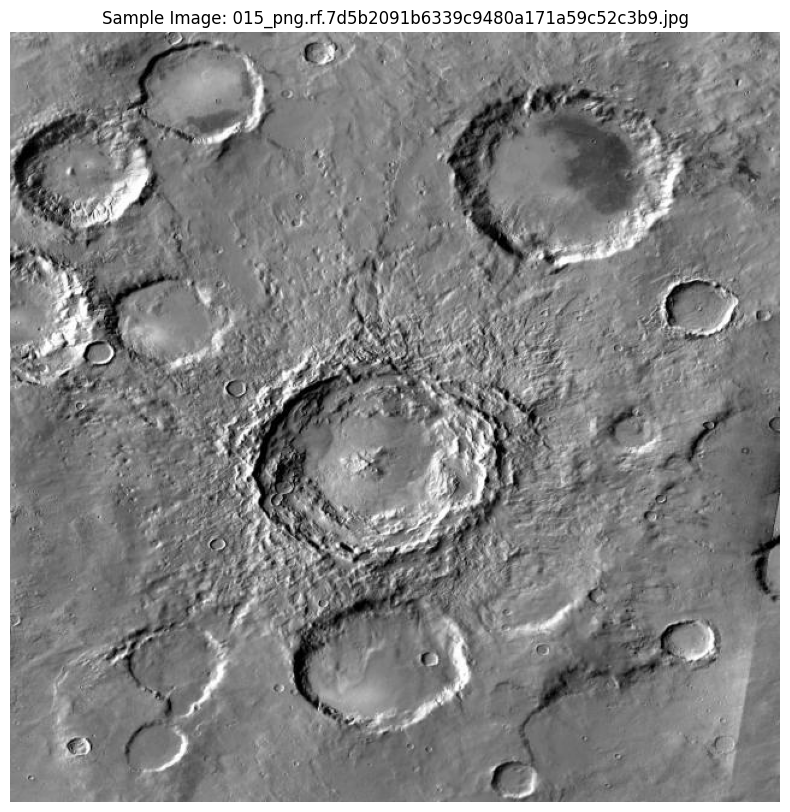

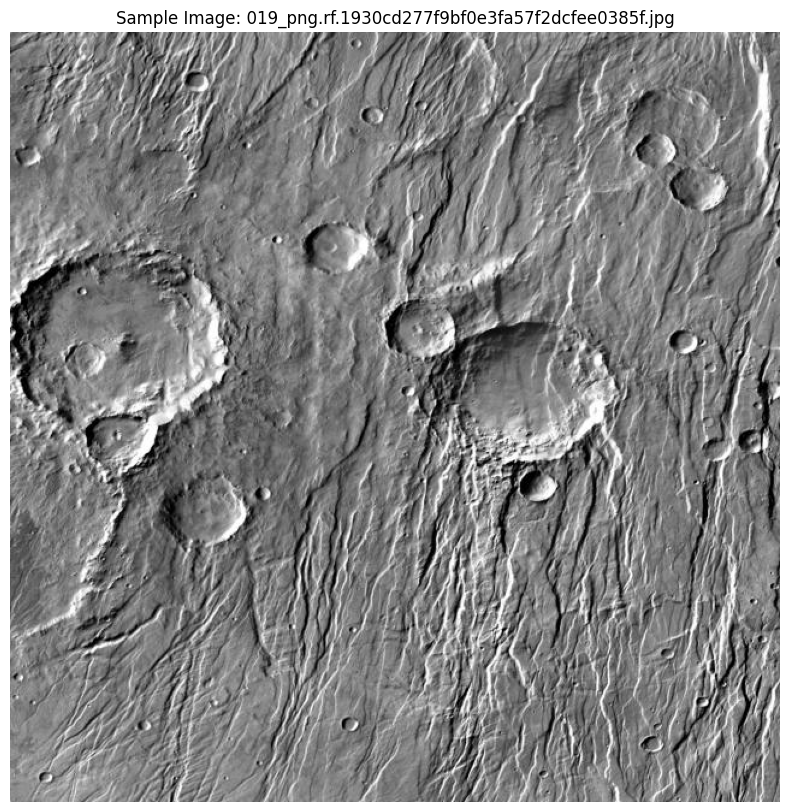

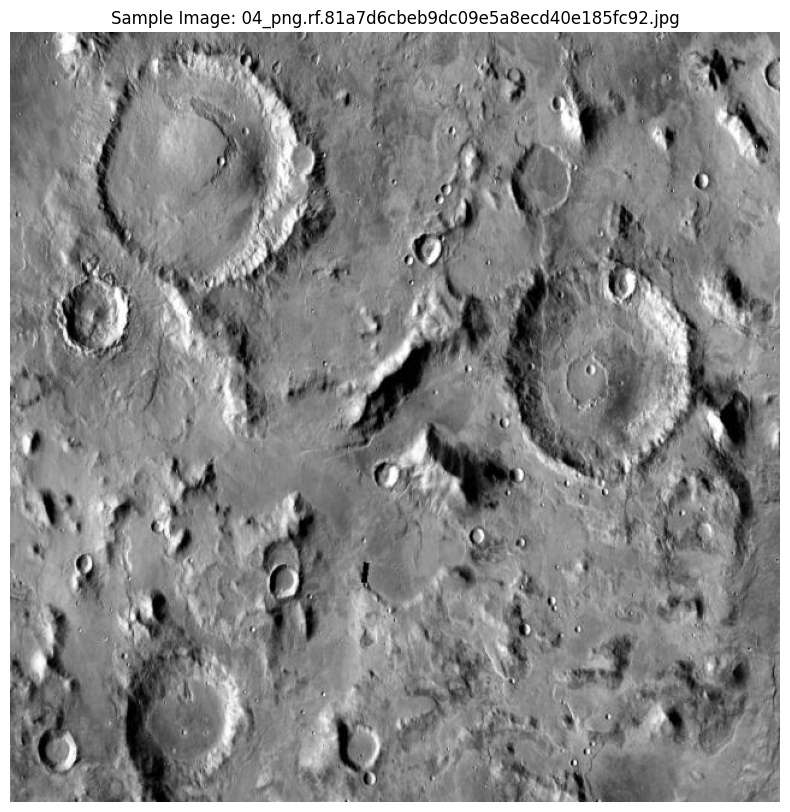

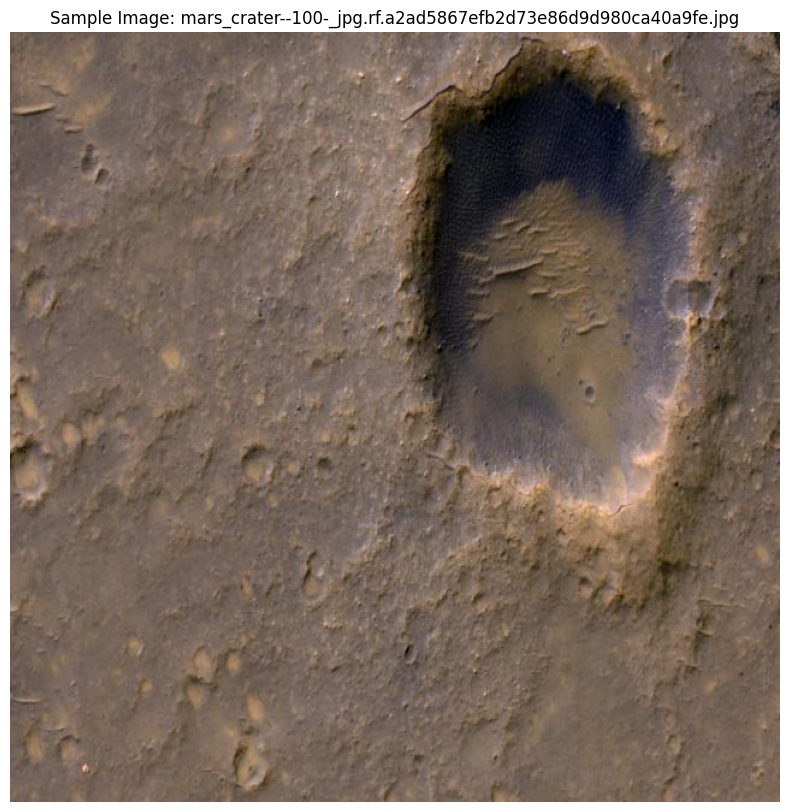

In [9]:
# Image Preprocessing and Visualization
def visualize_sample_images(image_path, label_df, n_samples=5):
    image_files = os.listdir(image_path)[:n_samples]
    for img_file in image_files:
        img_path = os.path.join(image_path, img_file)
        img = cv2.imread(img_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        
        fig, ax = plt.subplots(1, 1, figsize=(10, 10))
        ax.imshow(img)
        
        labels = label_df[label_df['file'] == img_file]
        for _, label in labels.iterrows():
            x_center = int(label['x_center'] * img.shape[1])
            y_center = int(label['y_center'] * img.shape[0])
            width = int(label['width'] * img.shape[1])
            height = int(label['height'] * img.shape[0])
            x_min = x_center - width // 2
            y_min = y_center - height // 2
            
            rect = plt.Rectangle((x_min, y_min), width, height, edgecolor='red', facecolor='none', linewidth=2)
            ax.add_patch(rect)
        
        plt.title(f'Sample Image: {img_file}')
        plt.axis('off')
        plt.show()

visualize_sample_images(train_img_path, train_labels)
visualize_sample_images(valid_img_path, valid_labels)
visualize_sample_images(test_img_path, test_labels)

In [10]:
# YOLOv8 Model Training and Evaluation
!pip install -q ultralytics
from ultralytics import YOLO


[notice] A new release of pip is available: 24.0 -> 24.1.2
[notice] To update, run: python.exe -m pip install --upgrade pip


In [11]:
# Load the model
model = YOLO('yolov8n.pt')

In [13]:
# Train the model
model.train(data=data_yaml_path, epochs=50)

Ultralytics YOLOv8.2.60  Python-3.12.4 torch-2.3.1+cpu CPU (Intel Core(TM) i5-10300H 2.50GHz)
engine\trainer: task=detect, mode=train, model=yolov8n.pt, data=dataset-lunar/data2.yaml, epochs=50, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train13, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True

100%|██████████| 755k/755k [00:00<00:00, 2.78MB/s]


Overriding model.yaml nc=80 with nc=1

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytics

Freezing layer 'model.22.dfl.conv.weight'


train: Scanning C:\Users\Asus\Desktop\i\react-crypto-app-master\react-crypto-app-master\isro-hackathon-2024\dataset-lunar\craters\train\labels...:   0%|          | 0/98 [00:00<?, ?it/s]Scanning C:\Users\Asus\Desktop\i\react-crypto-app-master\react-crypto-app-master\isro-hackathon-2024\dataset-lunar\craters\train\labels... 98 images, 9 backgrounds, 0 corrupt: 100%|██████████| 98/98 [00:00<00:00, 1488.84it/s]


train: New cache created: C:\Users\Asus\Desktop\i\react-crypto-app-master\react-crypto-app-master\isro-hackathon-2024\dataset-lunar\craters\train\labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


val: Scanning C:\Users\Asus\Desktop\i\react-crypto-app-master\react-crypto-app-master\isro-hackathon-2024\dataset-lunar\craters\valid\labels...:   0%|          | 0/26 [00:00<?, ?it/s]Scanning C:\Users\Asus\Desktop\i\react-crypto-app-master\react-crypto-app-master\isro-hackathon-2024\dataset-lunar\craters\valid\labels... 26 images, 2 backgrounds, 0 corrupt: 100%|██████████| 26/26 [00:00<00:00, 501.33it/s]


val: New cache created: C:\Users\Asus\Desktop\i\react-crypto-app-master\react-crypto-app-master\isro-hackathon-2024\dataset-lunar\craters\valid\labels.cache
Plotting labels to runs\detect\train13\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added 
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to runs\detect\train13
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50         0G      1.844      3.382      1.461         16        640: 100%|██████████| 7/7 [03:13<00:00, 27.68s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:15<00:00, 15.01s/it]


                   all         26        202     0.0167      0.644     0.0892     0.0372

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50         0G      1.512      2.361      1.252         28        640: 100%|██████████| 7/7 [02:06<00:00, 18.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.76s/it]


                   all         26        202      0.248      0.307      0.243      0.143

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50         0G      1.566      1.777      1.228         29        640: 100%|██████████| 7/7 [01:35<00:00, 13.61s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.10s/it]


                   all         26        202     0.0387      0.653       0.23      0.112

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50         0G      1.474      1.767      1.205         11        640: 100%|██████████| 7/7 [01:52<00:00, 16.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.64s/it]


                   all         26        202     0.0212      0.817      0.215      0.113

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50         0G      1.544      1.637       1.23         24        640: 100%|██████████| 7/7 [01:30<00:00, 12.99s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:10<00:00, 10.80s/it]


                   all         26        202      0.943     0.0826      0.304      0.166

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50         0G      1.531       1.62      1.255         10        640: 100%|██████████| 7/7 [01:33<00:00, 13.29s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:10<00:00, 10.90s/it]


                   all         26        202          1     0.0693      0.268      0.149

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50         0G      1.482      1.472      1.223         32        640: 100%|██████████| 7/7 [01:39<00:00, 14.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.74s/it]


                   all         26        202      0.952      0.197      0.501      0.267

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50         0G      1.494      1.435      1.265         16        640: 100%|██████████| 7/7 [01:41<00:00, 14.43s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.98s/it]


                   all         26        202      0.739      0.294      0.428      0.234

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50         0G      1.436      1.474      1.187         14        640: 100%|██████████| 7/7 [01:40<00:00, 14.41s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:12<00:00, 12.25s/it]


                   all         26        202      0.622       0.13      0.243      0.103

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50         0G      1.426      1.406      1.219         14        640: 100%|██████████| 7/7 [01:40<00:00, 14.31s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.82s/it]


                   all         26        202      0.596      0.211      0.261       0.13

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50         0G      1.449      1.394      1.166         35        640: 100%|██████████| 7/7 [01:37<00:00, 13.92s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.56s/it]


                   all         26        202      0.703      0.233      0.327      0.193

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50         0G      1.395      1.372      1.186         20        640: 100%|██████████| 7/7 [01:39<00:00, 14.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.82s/it]


                   all         26        202       0.54       0.32      0.325      0.184

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50         0G       1.45      1.521      1.233          6        640: 100%|██████████| 7/7 [01:39<00:00, 14.22s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.84s/it]


                   all         26        202      0.372      0.338      0.276      0.149

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50         0G      1.404       1.35      1.211         20        640: 100%|██████████| 7/7 [01:37<00:00, 14.00s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.48s/it]


                   all         26        202      0.258      0.366      0.226      0.122

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50         0G      1.454      1.399      1.208         14        640: 100%|██████████| 7/7 [01:40<00:00, 14.39s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:12<00:00, 12.33s/it]


                   all         26        202      0.627      0.436      0.509      0.287

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50         0G      1.473      1.379      1.226         17        640: 100%|██████████| 7/7 [01:41<00:00, 14.50s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.90s/it]


                   all         26        202      0.526      0.485      0.504      0.279

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50         0G      1.416      1.364      1.211         11        640: 100%|██████████| 7/7 [01:33<00:00, 13.42s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.61s/it]


                   all         26        202       0.48      0.503      0.459      0.256

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50         0G      1.424       1.29        1.2         18        640: 100%|██████████| 7/7 [01:33<00:00, 13.30s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.05s/it]


                   all         26        202      0.548      0.569      0.535      0.297

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50         0G      1.569      2.132      1.229          2        640: 100%|██████████| 7/7 [01:35<00:00, 13.61s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.43s/it]


                   all         26        202      0.681      0.535      0.576      0.325

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50         0G      1.347      1.248      1.134         18        640: 100%|██████████| 7/7 [01:35<00:00, 13.58s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.13s/it]


                   all         26        202      0.509      0.535      0.497      0.268

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50         0G      1.394       1.36      1.159         23        640: 100%|██████████| 7/7 [01:39<00:00, 14.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.12s/it]


                   all         26        202      0.552      0.487      0.485      0.262

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50         0G      1.364      1.253      1.173          9        640: 100%|██████████| 7/7 [01:35<00:00, 13.58s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:10<00:00, 10.67s/it]


                   all         26        202       0.64      0.525      0.576      0.322

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50         0G      1.383      1.277      1.181         35        640: 100%|██████████| 7/7 [01:34<00:00, 13.52s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:10<00:00, 10.68s/it]


                   all         26        202      0.611      0.575      0.607      0.348

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50         0G      1.452      1.331      1.208          9        640: 100%|██████████| 7/7 [01:36<00:00, 13.72s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:10<00:00, 10.70s/it]


                   all         26        202      0.647      0.582      0.629      0.335

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50         0G       1.37      1.239      1.205         15        640: 100%|██████████| 7/7 [01:38<00:00, 14.01s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:10<00:00, 11.00s/it]


                   all         26        202      0.657      0.559      0.617      0.326

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50         0G      1.394      1.239      1.209         18        640: 100%|██████████| 7/7 [01:38<00:00, 14.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:10<00:00, 10.66s/it]


                   all         26        202      0.628      0.609      0.619      0.346

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50         0G      1.291      1.165      1.147         46        640: 100%|██████████| 7/7 [01:36<00:00, 13.79s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.19s/it]


                   all         26        202      0.541      0.624      0.588      0.341

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50         0G      1.317      1.147       1.16         19        640: 100%|██████████| 7/7 [01:35<00:00, 13.69s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:10<00:00, 10.97s/it]


                   all         26        202      0.615      0.578      0.638      0.366

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50         0G      1.288      1.112      1.165         12        640: 100%|██████████| 7/7 [01:36<00:00, 13.83s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.41s/it]


                   all         26        202      0.671      0.584      0.652      0.369

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50         0G      1.249      1.112      1.097         10        640: 100%|██████████| 7/7 [01:35<00:00, 13.68s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:10<00:00, 10.89s/it]


                   all         26        202      0.679      0.597      0.658      0.365

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50         0G      1.263      1.036      1.119         37        640: 100%|██████████| 7/7 [01:35<00:00, 13.58s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:10<00:00, 10.61s/it]


                   all         26        202      0.554      0.649      0.608      0.338

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50         0G      1.217     0.9975      1.098         26        640: 100%|██████████| 7/7 [01:35<00:00, 13.71s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:10<00:00, 10.77s/it]


                   all         26        202      0.642      0.614      0.642      0.343

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50         0G      1.432      1.895      1.258          3        640: 100%|██████████| 7/7 [01:39<00:00, 14.20s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:12<00:00, 12.08s/it]


                   all         26        202      0.679      0.614      0.655      0.354

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50         0G      1.303      1.198      1.145          7        640: 100%|██████████| 7/7 [01:52<00:00, 16.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:12<00:00, 12.67s/it]


                   all         26        202      0.668      0.629       0.65      0.357

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50         0G      1.283      1.086      1.095         10        640: 100%|██████████| 7/7 [01:47<00:00, 15.41s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.04s/it]


                   all         26        202      0.641      0.614       0.63      0.354

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50         0G      1.246      1.106      1.104          8        640: 100%|██████████| 7/7 [01:40<00:00, 14.42s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.06s/it]


                   all         26        202      0.638      0.644      0.661      0.371

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50         0G      1.253      1.073      1.117         49        640: 100%|██████████| 7/7 [01:38<00:00, 14.01s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.45s/it]


                   all         26        202      0.654      0.649      0.675      0.379

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50         0G      1.131      1.055      1.086          3        640: 100%|██████████| 7/7 [01:37<00:00, 13.94s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.54s/it]


                   all         26        202      0.696       0.59      0.663      0.371

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50         0G      1.171     0.9836      1.055          9        640: 100%|██████████| 7/7 [01:38<00:00, 14.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:10<00:00, 10.95s/it]


                   all         26        202      0.677      0.569      0.648       0.36

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50         0G      1.233     0.9976      1.095         23        640: 100%|██████████| 7/7 [01:38<00:00, 14.02s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:10<00:00, 10.71s/it]


                   all         26        202      0.661      0.588      0.654      0.367
Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50         0G      1.239      1.316      1.105          4        640: 100%|██████████| 7/7 [01:37<00:00, 13.90s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:10<00:00, 10.92s/it]


                   all         26        202      0.593      0.629      0.655      0.365

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50         0G      1.267      1.082      1.066         21        640: 100%|██████████| 7/7 [01:37<00:00, 13.90s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.06s/it]


                   all         26        202      0.626      0.574      0.646      0.372

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50         0G       1.23      1.065      1.092          4        640: 100%|██████████| 7/7 [01:37<00:00, 13.97s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:10<00:00, 10.90s/it]


                   all         26        202      0.608      0.594      0.644      0.368

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50         0G      1.159      1.033      1.175          3        640: 100%|██████████| 7/7 [01:44<00:00, 14.94s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:18<00:00, 18.15s/it]


                   all         26        202      0.625      0.599      0.637       0.36

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50         0G      1.209      1.037      1.118         40        640: 100%|██████████| 7/7 [02:16<00:00, 19.54s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.20s/it]


                   all         26        202      0.702      0.579       0.64      0.364

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50         0G       1.15     0.9924       1.09          3        640: 100%|██████████| 7/7 [01:41<00:00, 14.55s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.06s/it]


                   all         26        202      0.708      0.564      0.643      0.367

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50         0G      1.236     0.9876      1.073         24        640: 100%|██████████| 7/7 [01:48<00:00, 15.47s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:13<00:00, 13.37s/it]


                   all         26        202      0.646      0.587      0.649      0.366

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50         0G      1.279     0.9783      1.136          9        640: 100%|██████████| 7/7 [01:45<00:00, 15.03s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:12<00:00, 12.13s/it]


                   all         26        202      0.628      0.639      0.652      0.371

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50         0G      1.211      1.059       1.07         18        640: 100%|██████████| 7/7 [01:41<00:00, 14.57s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.68s/it]


                   all         26        202      0.616      0.644      0.654       0.37

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50         0G      1.047      1.001      1.052          4        640: 100%|██████████| 7/7 [01:39<00:00, 14.20s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:11<00:00, 11.95s/it]


                   all         26        202      0.614      0.649      0.658      0.373

50 epochs completed in 1.614 hours.
Optimizer stripped from runs\detect\train13\weights\last.pt, 6.2MB
Optimizer stripped from runs\detect\train13\weights\best.pt, 6.2MB

Validating runs\detect\train13\weights\best.pt...
Ultralytics YOLOv8.2.60  Python-3.12.4 torch-2.3.1+cpu CPU (Intel Core(TM) i5-10300H 2.50GHz)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:09<00:00,  9.50s/it]


                   all         26        202      0.654      0.649      0.675      0.379
Speed: 5.7ms preprocess, 342.2ms inference, 0.0ms loss, 6.7ms postprocess per image
Results saved to runs\detect\train13


lr/pg0,▁▂▃▃▄▅▆▆▇▇████▇▇▇▇▆▆▆▆▅▅▅▅▄▄▄▄▃▃▃▃▂▂▂▂▁▁
lr/pg1,▁▂▃▃▄▅▆▆▇▇████▇▇▇▇▆▆▆▆▅▅▅▅▄▄▄▄▃▃▃▃▂▂▂▂▁▁
lr/pg2,▁▂▃▃▄▅▆▆▇▇████▇▇▇▇▆▆▆▆▅▅▅▅▄▄▄▄▃▃▃▃▂▂▂▂▁▁
metrics/mAP50(B),▁▃▃▂▃▆▅▃▄▄▃▃▆▅▆▇▆▇▇▇▇▇██▇███████████████
metrics/mAP50-95(B),▁▃▃▃▃▆▅▂▄▄▃▃▆▅▆▇▆▇▇▇▇▇██▇▇▇█████████████
metrics/precision(B),▁▃▁▁██▆▅▆▅▄▃▅▄▅▆▅▅▅▅▅▅▅▆▅▅▆▆▅▆▆▆▅▅▅▅▆▅▅▆
metrics/recall(B),▆▃▆█▁▂▃▂▃▃▄▄▅▅▆▅▅▅▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆
model/GFLOPs,▁
model/parameters,▁
model/speed_PyTorch(ms),▁
train/box_loss,█▅▆▅▅▅▅▄▅▄▅▄▅▄▄▆▄▄▄▅▄▃▃▃▃▂▄▃▃▃▂▂▃▃▃▂▂▃▃▁


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x00000143A521A270>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.0480

In [16]:


# Save the trained model
import os

# Define the path to save the model
model_save_path = '/trained/best_model.pt'

# Create the directory if it doesn't exist
os.makedirs(os.path.dirname(model_save_path), exist_ok=True)

# Evaluate the model
results = model.val()

# Save the trained model
model.save(model_save_path)


Ultralytics YOLOv8.2.60  Python-3.12.4 torch-2.3.1+cpu CPU (Intel Core(TM) i5-10300H 2.50GHz)


val: Scanning C:\Users\Asus\Desktop\i\react-crypto-app-master\react-crypto-app-master\isro-hackathon-2024\dataset-lunar\craters\valid\labels.cache... 26 images, 2 backgrounds, 0 corrupt: 100%|██████████| 26/26 [00:00<?, ?it/s]Scanning C:\Users\Asus\Desktop\i\react-crypto-app-master\react-crypto-app-master\isro-hackathon-2024\dataset-lunar\craters\valid\labels.cache... 26 images, 2 backgrounds, 0 corrupt: 100%|██████████| 26/26 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:10<00:00,  5.39s/it]


                   all         26        202      0.654      0.649      0.675      0.379
Speed: 8.4ms preprocess, 380.4ms inference, 0.0ms loss, 6.6ms postprocess per image
Results saved to runs\detect\train134



image 1/1 c:\Users\Asus\Desktop\i\react-crypto-app-master\react-crypto-app-master\isro-hackathon-2024\dataset-lunar\craters\test\images\010_png.rf.fcf5e274562ee69a325f9d7a0b30767f.jpg: 640x640 28 class_0s, 291.2ms
Speed: 15.0ms preprocess, 291.2ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


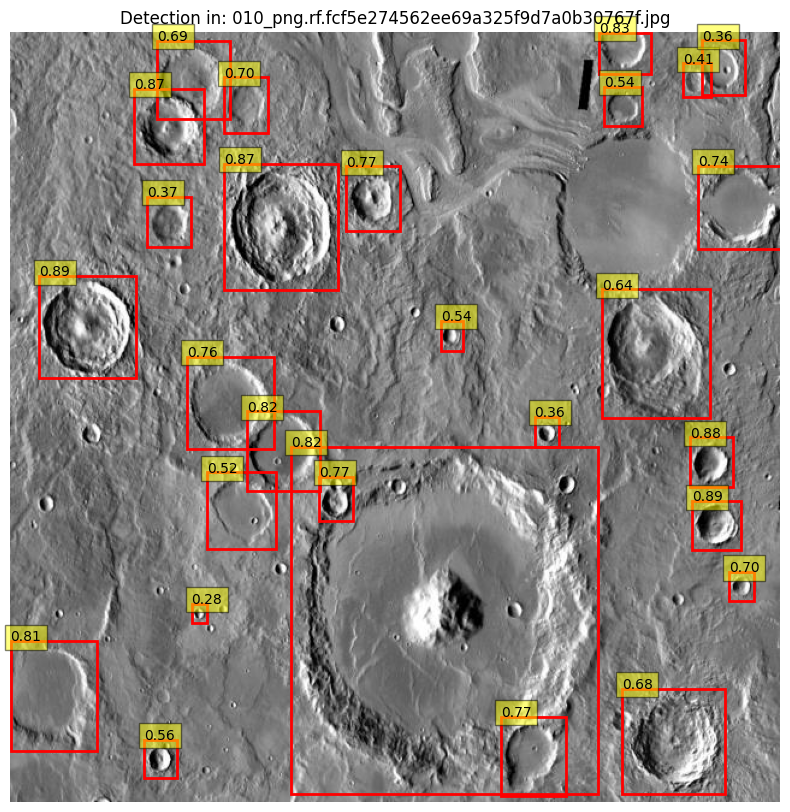


image 1/1 c:\Users\Asus\Desktop\i\react-crypto-app-master\react-crypto-app-master\isro-hackathon-2024\dataset-lunar\craters\test\images\015_png.rf.7d5b2091b6339c9480a171a59c52c3b9.jpg: 640x640 15 class_0s, 298.2ms
Speed: 6.0ms preprocess, 298.2ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


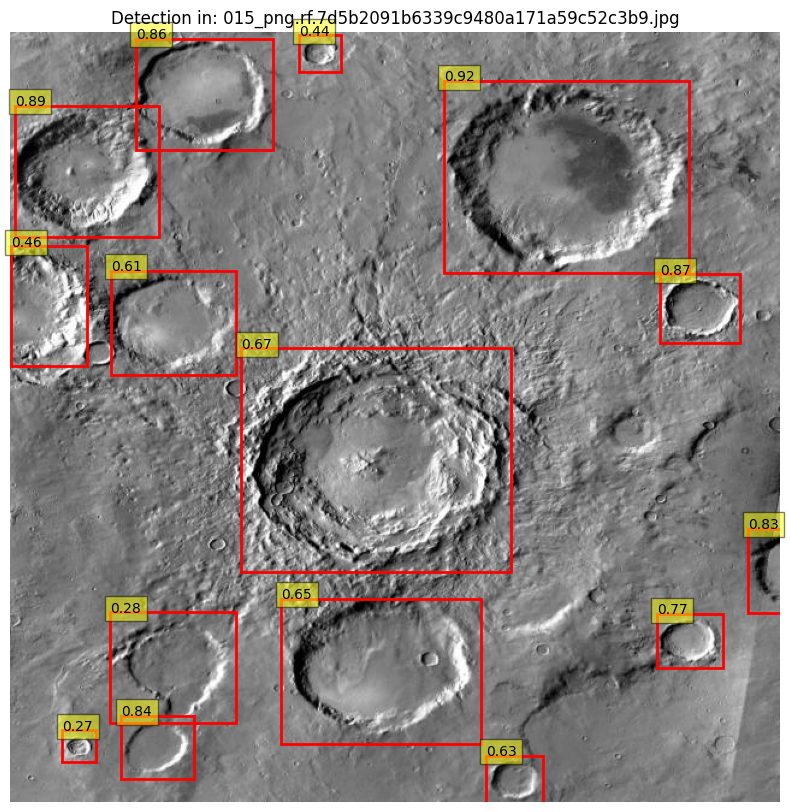


image 1/1 c:\Users\Asus\Desktop\i\react-crypto-app-master\react-crypto-app-master\isro-hackathon-2024\dataset-lunar\craters\test\images\019_png.rf.1930cd277f9bf0e3fa57f2dcfee0385f.jpg: 640x640 7 class_0s, 364.6ms
Speed: 7.9ms preprocess, 364.6ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


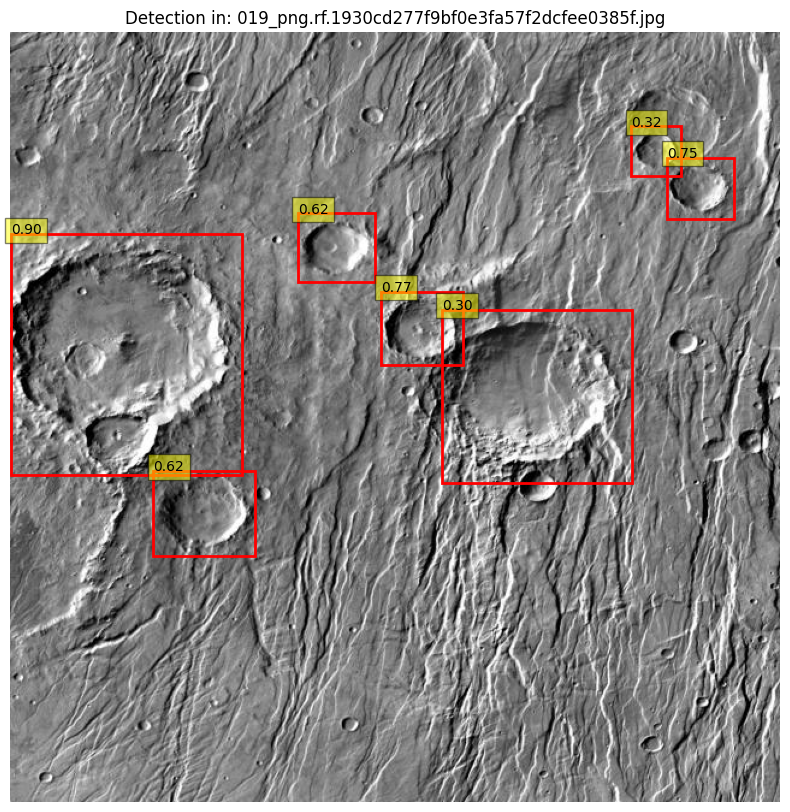


image 1/1 c:\Users\Asus\Desktop\i\react-crypto-app-master\react-crypto-app-master\isro-hackathon-2024\dataset-lunar\craters\test\images\04_png.rf.81a7d6cbeb9dc09e5a8ecd40e185fc92.jpg: 640x640 16 class_0s, 270.8ms
Speed: 9.0ms preprocess, 270.8ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


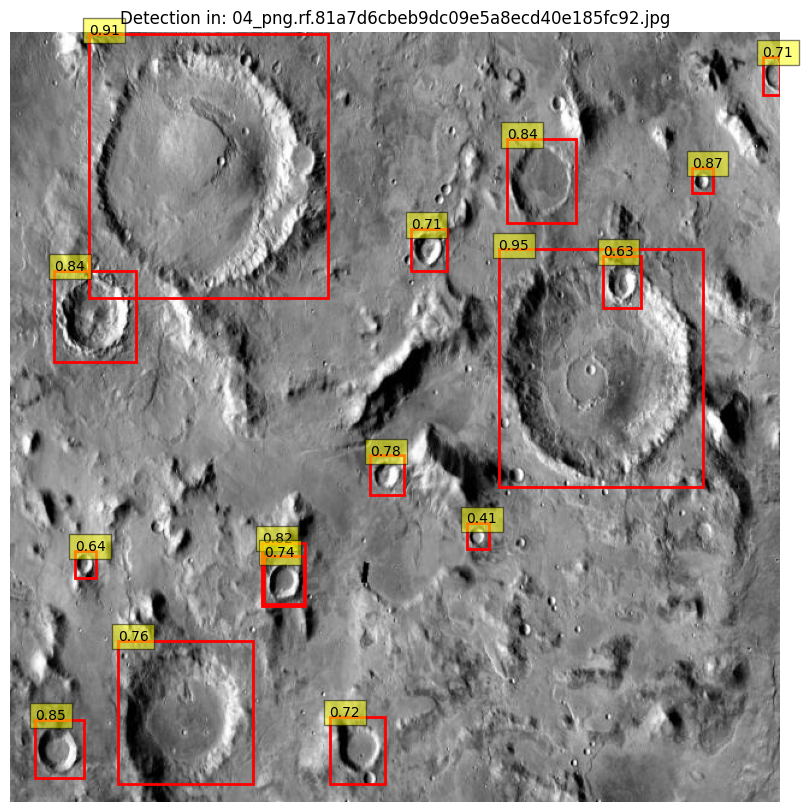


image 1/1 c:\Users\Asus\Desktop\i\react-crypto-app-master\react-crypto-app-master\isro-hackathon-2024\dataset-lunar\craters\test\images\mars_crater--100-_jpg.rf.a2ad5867efb2d73e86d9d980ca40a9fe.jpg: 640x640 6 class_0s, 423.6ms
Speed: 10.0ms preprocess, 423.6ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


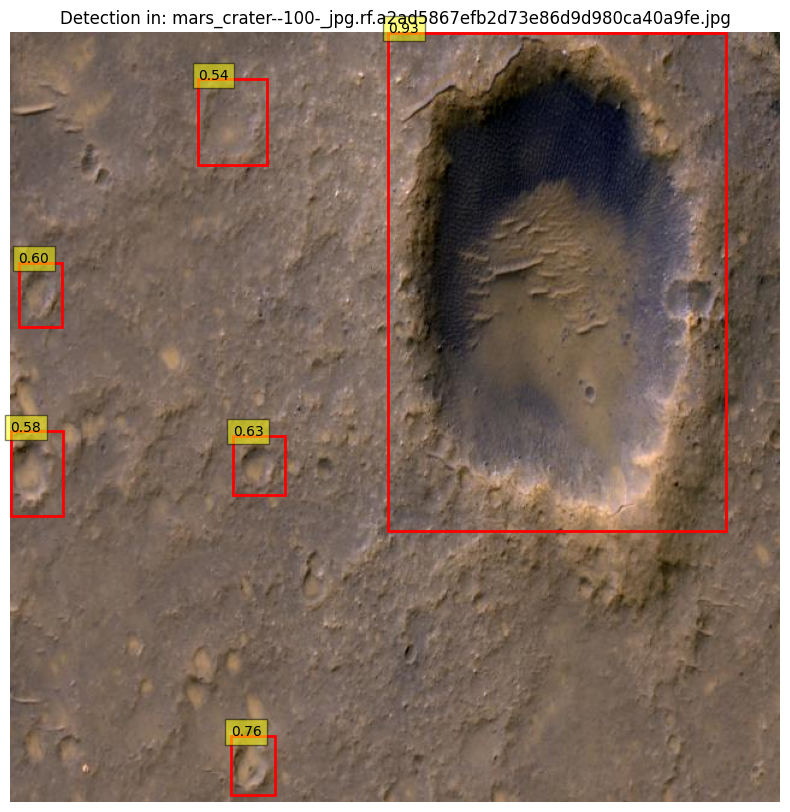


image 1/1 c:\Users\Asus\Desktop\i\react-crypto-app-master\react-crypto-app-master\isro-hackathon-2024\dataset-lunar\craters\test\images\mars_crater--108-_jpg.rf.9395f473f249e064dbfea078e2519a17.jpg: 640x640 28 class_0s, 323.7ms
Speed: 5.0ms preprocess, 323.7ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


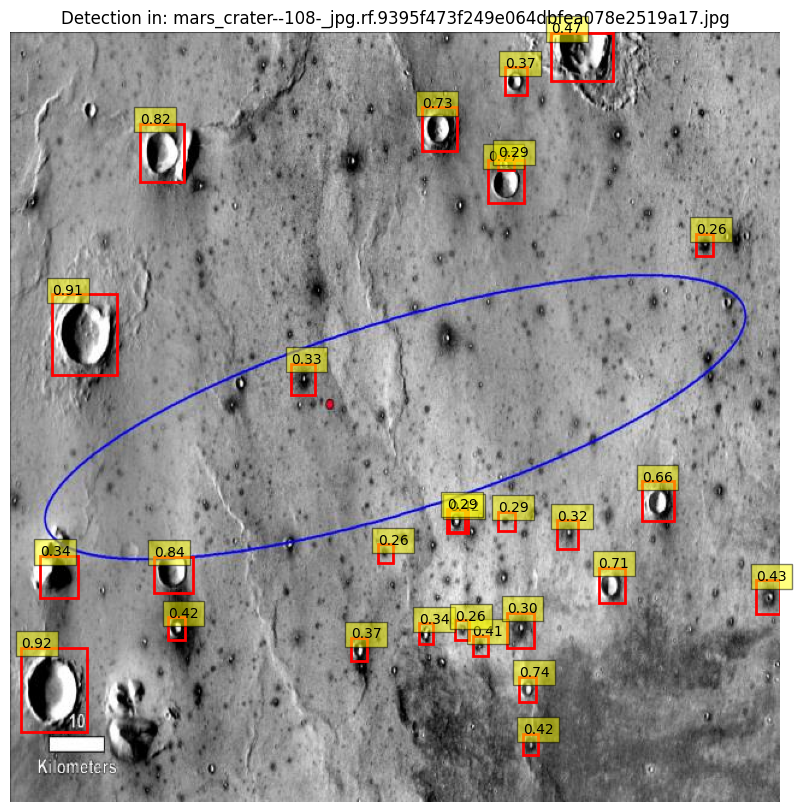


image 1/1 c:\Users\Asus\Desktop\i\react-crypto-app-master\react-crypto-app-master\isro-hackathon-2024\dataset-lunar\craters\test\images\mars_crater--116-_jpg.rf.2e550a693a8800808e68848484716b95.jpg: 640x640 6 class_0s, 364.1ms
Speed: 5.0ms preprocess, 364.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


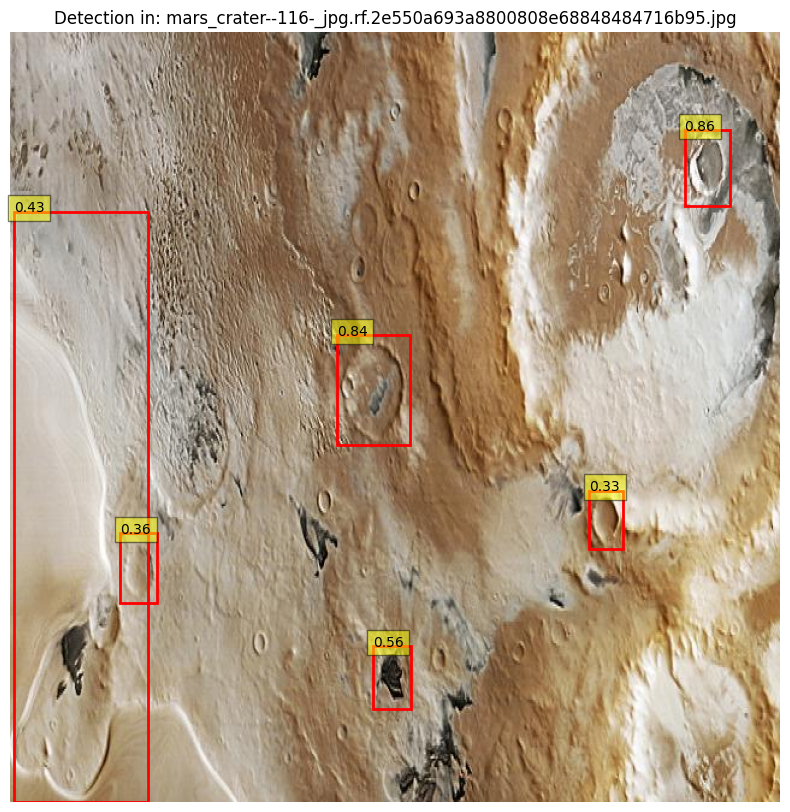


image 1/1 c:\Users\Asus\Desktop\i\react-crypto-app-master\react-crypto-app-master\isro-hackathon-2024\dataset-lunar\craters\test\images\mars_crater--117-_jpg.rf.b412b6593d102c5f9dda7bce79bb815c.jpg: 640x640 5 class_0s, 410.4ms
Speed: 7.9ms preprocess, 410.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


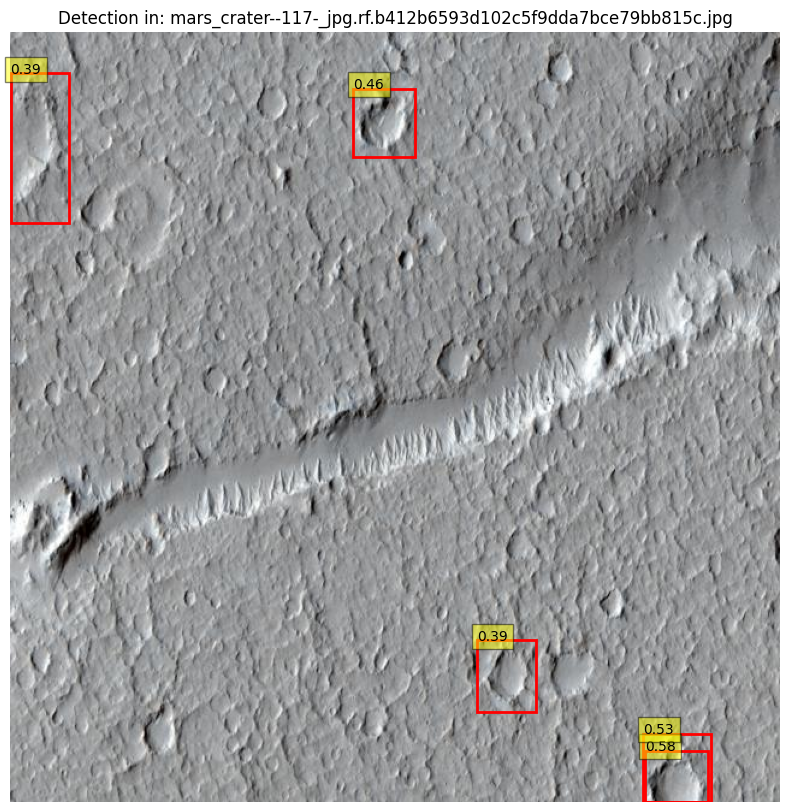


image 1/1 c:\Users\Asus\Desktop\i\react-crypto-app-master\react-crypto-app-master\isro-hackathon-2024\dataset-lunar\craters\test\images\mars_crater--12-_jpg.rf.26060e7ca4ca8781bcaf011b9b70b7db.jpg: 640x640 1 class_0, 397.3ms
Speed: 13.0ms preprocess, 397.3ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


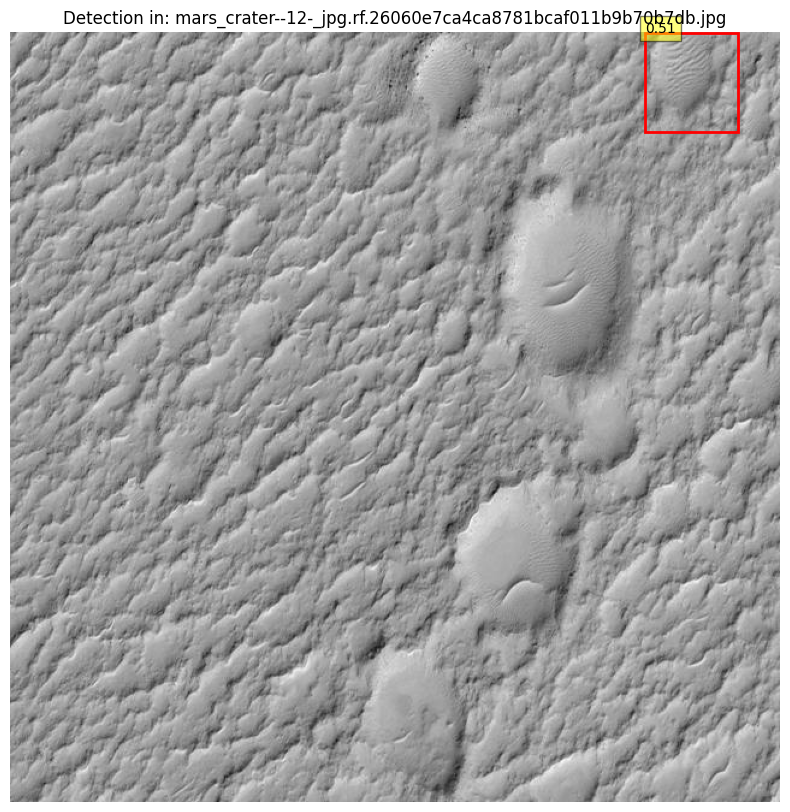


image 1/1 c:\Users\Asus\Desktop\i\react-crypto-app-master\react-crypto-app-master\isro-hackathon-2024\dataset-lunar\craters\test\images\mars_crater--25-_jpg.rf.a06bfa24b404b064ead471f56d636e0e.jpg: 640x640 12 class_0s, 349.0ms
Speed: 7.0ms preprocess, 349.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


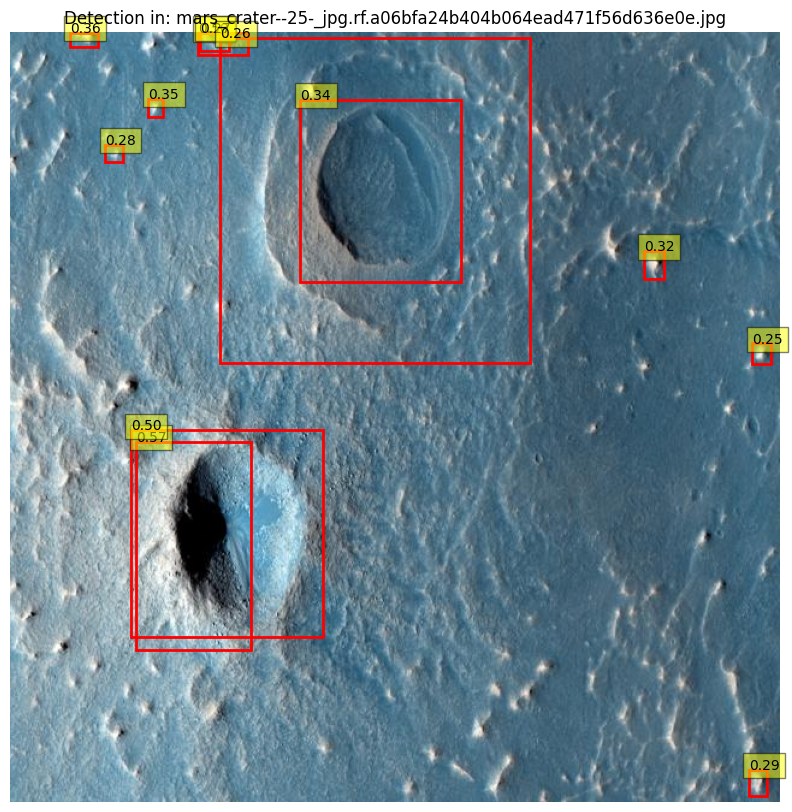

Model training, evaluation, and sample visualization completed. The trained model is saved at '/kaggle/working/best_model.pt'.


In [17]:
# Visualize sample detections
def visualize_detections(model, image_path, n_samples=10):
    image_files = os.listdir(image_path)[:n_samples]
    for img_file in image_files:
        img_path = os.path.join(image_path, img_file)
        img = cv2.imread(img_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        results = model(img_path)
        
        fig, ax = plt.subplots(1, 1, figsize=(10, 10))
        ax.imshow(img)
        
        for result in results[0].boxes:
            x_min, y_min, x_max, y_max = result.xyxy[0].tolist()
            conf = result.conf[0].item()
            rect = plt.Rectangle((x_min, y_min), x_max - x_min, y_max - y_min, edgecolor='red', facecolor='none', linewidth=2)
            ax.add_patch(rect)
            ax.text(x_min, y_min, f'{conf:.2f}', bbox=dict(facecolor='yellow', alpha=0.5))
        
        plt.title(f'Detection in: {img_file}')
        plt.axis('off')
        plt.show()

visualize_detections(model, test_img_path)

print("Model training, evaluation, and sample visualization completed. The trained model is saved at '/kaggle/working/best_model.pt'.")